# DCGAN

In [ ]:
!pip install wandb
import wandb
import torch
from torch.utils.data import Dataset, DataLoader
from pathlib import Path
from typing import Dict, List, Any
from PIL import Image
from datetime import datetime
from torchvision.transforms import ToTensor, Compose, Normalize
import torch.nn.functional as F
import numpy as np
import random
from torch.nn import Conv2d, BatchNorm2d, ReLU, MaxPool2d, Sequential, Sigmoid, Upsample, ModuleList, LeakyReLU, Linear
import matplotlib.pyplot as plt
from typing import Any

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.4/196.4 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 257.5/257.5 kB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.5 MB/s eta 0:00:00


In [ ]:
# Setting seeds

def set_seeds(seed: int=42):
    """Sets random sets for torch operations.

    Args:
        seed (int, optional): Random seed to set. Defaults to 42.
    """
    # Set the seed for general torch operations
    torch.manual_seed(seed)
    # Set the seed for CUDA torch operations (ones that happen on the GPU)
    torch.cuda.manual_seed(seed)

set_seeds(19890)

## Inputs

Let’s define some inputs for the run:

-  ``workers`` - the number of worker threads for loading the data with
   the ``DataLoader``.
-  ``batch_size`` - the batch size used in training. The DCGAN paper
   uses a batch size of 128.
-  ``image_size`` - the spatial size of the images used for training.
   This implementation defaults to 64x64. If another size is desired,
   the structures of D and G must be changed. See
   [here](https://github.com/pytorch/examples/issues/70)_ for more
   details.
-  ``nc`` - number of color channels in the input images. For color
   images this is 3.
-  ``nz`` - length of latent vector.
-  ``ngf`` - relates to the depth of feature maps carried through the
   generator.
-  ``ndf`` - sets the depth of feature maps propagated through the
   discriminator.
-  ``num_epochs`` - number of training epochs to run. Training for
   longer will probably lead to better results but will also take much
   longer.
-  ``lr`` - learning rate for training. As described in the DCGAN paper,
   this number should be 0.0002.
-  ``beta1`` - beta1 hyperparameter for Adam optimizers. As described in
   paper, this number should be 0.5.
-  ``ngpu`` - number of GPUs available. If this is 0, code will run in
   CPU mode. If this number is greater than 0 it will run on that number
   of GPUs.
-  ``GDRIVE`` - Set to True if the (already preprocessed) raw image/mask dataset is stored in a Google Drive personal folder (with path specified some cells below). False if the dataset is stored locally.




In [ ]:
# Number of workers for dataloader
workers = 2

# Batch size used to split the dataset and train the model [128 in Default DCGAN]
batch_size = 256

# Image size as input to the model (either 64 or 256)
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input) [100 in Default DCGAN]
nz = 100

# Size of feature maps in generator [64 in Default DCGAN]
ngf = 16

# Size of feature maps in discriminator [64 in Default DCGAN]
ndf = 64

# Number of training epochs
num_epochs = 60

# Learning rate for optimizers [0.0002 in Default DCGAN]
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers [0.5 in Default DCGAN]
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# Use dataset stored on Google Drive personal folder if True, use local dataset if False
GDRIVE = True

# Avoid printing images used to train the model if True, shows em if False.
CENSOR = False


config = {
    "architecture":"DCGAN-resizeconv",
    "nc": nc,
    "nz": nz,
    "ngf": ngf,
    "ndf": ndf,
    "num_epochs": num_epochs,
    "lr": lr,
    "beta1": beta1,
    "ngpu": ngpu,
    }

## Dataset creation

Our dataset is made up of image-color mask pairs, but since we use a non-conditional GAN, we don't make use of the masks.

- The images are converted from PIL format to tensors in [0,1] and later rescaled in the range [-1,1] to comply with Tanh function range
- No channel normalization is done, since it would require to remember the pre-normalization range, which can't be done for generated images.

**N.B.:** If channel normalization would be done after rescaling in [-1,1], we would have images that are potentially unbounded (since they lie on a standard normal) and can't be used with a Tanh function.

In [ ]:
class MaskPairDataset(Dataset):
    '''
    MaskPairDataset: Custom PyTorch Dataset for paired image-mask data.

    Args:
        base_folder (Path): Root directory containing image-mask pairs.
        transforms (optional): Image transformations (default: None).
        img_norm (Normalize, optional): Normalization for images (default: None).
        mask_norm (Normalize, optional): Normalization for masks (default: None).
        suffix (str, optional): Suffix identifying mask files (default: "_mask").
        is_mask_rgb (bool, optional): Flag indicating if masks are in RGB format (default: False).

    Attributes:
        transforms: Image transformations.
        img_norm: Normalization for images.
        mask_norm: Normalization for masks.
        is_mask_rgb: Flag indicating mask format.

    Methods:
        __init__: Initialize MaskPairDataset object.
        __len__: Get the length of the dataset.
        __getitem__: Retrieve an item (image and its corresponding mask) by index.

    Usage Example:
    >>> dataset = MaskPairDataset(base_folder=Path('data'), transforms=transforms, img_norm=img_norm, mask_norm=mask_norm)
    >>> sample = dataset[0]
    >>> print(sample['img'], sample['mask'])
    '''


    def __init__(self, base_folder : Path, transforms = None, img_norm: Normalize = None, mask_norm: Normalize=None, suffix:str = "_mask", is_mask_rgb:bool = False):
        '''
        Initializes the MaskPairDataset with provided parameters.

        Args:
            base_folder (Path): Root directory containing image-mask pairs.
            transforms (optional): Image transformations (default: None).
            img_norm (Normalize, optional): Normalization for images (default: None).
            mask_norm (Normalize, optional): Normalization for masks (default: None).
            suffix (str, optional): Suffix identifying mask files (default: "_mask").
            is_mask_rgb (bool, optional): Flag indicating if masks are in RGB format (default: False).
        '''
        self.transforms = transforms
        self.img_norm = img_norm
        self.mask_norm = mask_norm
        self.is_mask_rgb = is_mask_rgb

        # Get all png images in the folder
        img_list = base_folder.glob("*.png")
        # Remove the masks
        img_list = [img for img in img_list if "mask" not in img.name]

        # Create the pairs
        self.paired_data = []
        for img in img_list:
            supposed_mask = base_folder / (img.stem + suffix + ".png")
            if supposed_mask.is_file():
                self.paired_data.append((img, supposed_mask))


    def __len__(self) -> int:
        '''
        Returns the total number of paired image-mask data in the dataset.

        Returns:
            int: Length of paired data.
        '''

        return len(self.paired_data)


    def __getitem__(self, index) -> Dict:
        '''
        Retrieves an item (image and its corresponding mask) by index.

        Args:
            index (int): Index of the item to retrieve.

        Returns:
            Dict: A dictionary containing 'img' (image) and 'mask' (corresponding mask).
        '''

        img_path, mask_path = self.paired_data[index]
        img = Image.open(img_path).convert("RGB")
        if self.is_mask_rgb:
            mask = Image.open(mask_path).convert("RGB")
        else:
            mask = Image.open(mask_path).convert("L")

        # Apply transforms
        if self.transforms is not None:
            # Make sure that random transforms to both image and mask behave in the same way
            seed = np.random.randint(2147483647)

            random.seed(seed)
            torch.manual_seed(seed)
            img = self.transforms(img)

            random.seed(seed)
            torch.manual_seed(seed)
            mask = self.transforms(mask)
        if self.mask_norm is not None:
            mask = self.mask_norm(mask)
        if self.img_norm is not None:
            img = self.img_norm(img)
        img = img *2-1 # Scale in [-1,1]
        return {"img":img, "mask":mask}


In [ ]:
import os
# accessing GDrive preprocessed dataset folder
if GDRIVE:
    from google.colab import drive
    drive.mount('/content/gdrive/', force_remount=True)

# accessing dataset folder and printing files contained in it
os.chdir('./gdrive/MyDrive/AII Project/experiments-synthetic-generation-clinical-skin-images-main')
!ls

Mounted at /content/gdrive/
 crops				  glide_model_cache   README.md
 dataset			  LICENSE	      saved_models
 DERMDiff.ipynb			  lightning_logs      test_images
 DERMGAN.ipynb			  logs		      Test_sock_burn3
 diffusion_models.py		  low_contrast	      wandb
 generated_images		  Old		     'WANDB_DCGAN_128(2024)'
 generate_images.ipynb		  OUR_MODELS.ipynb   'WANDB_DCGAN_128(2024) (1)'
'GLIDE Iterative Inpaint.ipynb'   outputs-gan	     'WANDB_DCGAN_64(2024)'


In [ ]:
# Building the dataset and dataloader (just rerun in case of errors for input/output)
import torchvision.transforms as transforms

base_folder = Path("./crops")

if image_size != 256:
    transforms = transforms.Compose([transforms.CenterCrop((image_size,image_size)), ToTensor()])


else:
    transforms = transforms.Compose([ToTensor()])



dataset = MaskPairDataset(base_folder, transforms=transforms, suffix="_mask2", is_mask_rgb=True)#, img_norm=Normalize(mean=means, std=stds), mask_norm=Normalize(mean=[0.5], std=[0.5]))

print('This dataset contains {} samples, with dimension {},{}'.format(len(dataset),dataset[0]['img'].shape,dataset[0]['mask'].shape))


This dataset contains 11994 samples, with dimension torch.Size([3, 128, 128]),torch.Size([3, 128, 128])


In [ ]:
# visualizing a transformed sample (remember that ToTensor() maps from [0-255] to [-1,1])
dataset[0]

{'img': tensor([[[-0.0353, -0.0353, -0.0353,  ...,  0.0275,  0.0275,  0.0039],
          [-0.0275, -0.0196, -0.0275,  ...,  0.0353,  0.0353,  0.0039],
          [-0.0510, -0.0039,  0.0039,  ...,  0.0118,  0.0196,  0.0039],
          ...,
          [ 0.0824,  0.0824,  0.0745,  ...,  0.0902,  0.1059,  0.1137],
          [ 0.0824,  0.0824,  0.0824,  ...,  0.0824,  0.0980,  0.1059],
          [ 0.0667,  0.0745,  0.0824,  ...,  0.0745,  0.0824,  0.0902]],
 
         [[-0.2549, -0.2549, -0.2549,  ..., -0.1765, -0.1765, -0.2000],
          [-0.2471, -0.2392, -0.2471,  ..., -0.1686, -0.1686, -0.2000],
          [-0.2549, -0.2078, -0.2000,  ..., -0.1922, -0.1843, -0.2000],
          ...,
          [-0.1216, -0.1216, -0.1294,  ..., -0.1608, -0.1451, -0.1373],
          [-0.1216, -0.1216, -0.1216,  ..., -0.1686, -0.1608, -0.1529],
          [-0.1373, -0.1294, -0.1216,  ..., -0.1765, -0.1765, -0.1686]],
 
         [[-0.3490, -0.3490, -0.3490,  ..., -0.2784, -0.2784, -0.3020],
          [-0.3412, -

## Data

Here we create training batches from the original dataset


In [ ]:
import torchvision.utils as vutils

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")


# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)


# Plot some training images
if False:
    real_batch = next(iter(dataloader))
    plt.figure(figsize=(8,8))
    plt.axis("off")
    plt.title("Training Images")
    plt.imshow(np.transpose(vutils.make_grid(real_batch['img'].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
    plt.show()

## Implementation

With our input parameters set and the dataset prepared, we can now get
into the implementation. We will start with the weight initialization
strategy, then talk about the generator, discriminator, loss functions,
and training loop in detail.

### Weight Initialization

From the DCGAN paper, the authors specify that all model weights shall
be randomly initialized from a Normal distribution with ``mean=0``,
``stdev=0.02``. The ``weights_init`` function takes an initialized model as
input and reinitializes all convolutional, convolutional-transpose, and
batch normalization layers to meet this criteria. This function is
applied to the models immediately after initialization.




In [ ]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Generator

The generator, $G$, is designed to map the latent space vector
($z$) to data-space. Since our data are images, converting
$z$ to data-space means ultimately creating a RGB image with the
same size as the training images (i.e. 3x64x64). In practice, this is
accomplished through a series of strided two dimensional *resize-convolution* layers (instead of convolutional
transpose layers, to [avoid checkerboard-like artifacts](https://distill.pub/2016/deconv-checkerboard/)) each paired with a 2d batch norm layer and a relu
activation. The output of the generator is fed through a tanh function
to return it to the input data range of $[-1,1]$. It is worth
noting the existence of the batch norm functions after the
resize-convolution layers, as this is a critical contribution of the DCGAN
paper. These layers help with the flow of gradients during training.

Notice, how the inputs we set in the input section (``nz``, ``ngf``, and
``nc``) influence the generator architecture in code. ``nz`` is the length
of the z input vector, ``ngf`` relates to the size of the feature maps
that are propagated through the generator, and ``nc`` is the number of
channels in the output image (set to 3 for RGB images). Below is the
code for the generator.




In [ ]:
import torch.nn as nn
# Generator Code

class Generator(nn.Module):

    def convblock_resizeconv(self, in_channels, out_channels, scale_factor=2):
        '''
        https://distill.pub/2016/deconv-checkerboard/
        '''
        block =  nn.Sequential(
            nn.Upsample(scale_factor = scale_factor, mode='bilinear'),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=0),
            nn.Conv2d(out_channels, out_channels, 4, 1, bias=False, padding='same'),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True),
            nn.Dropout2d(0.2),)

        return block

    def convblock_out(self, in_channels, out_channels):
        '''
        https://distill.pub/2016/deconv-checkerboard/
        '''
        block =  nn.Sequential(
            nn.Upsample(scale_factor = 2, mode='bilinear'),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=0),)

        return block

    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            self.convblock_resizeconv(in_channels=nz, out_channels=ngf*32),
            # state size. ``(ngf*32) x 2 x 2``
            self.convblock_resizeconv(in_channels=ngf*32, out_channels=ngf*16),
            # state size. ``(ngf*16) x 4 x 4``
            self.convblock_resizeconv(in_channels=ngf*16, out_channels=ngf*8),
            # state size. ``(ngf*8) x 8 x 8``
            self.convblock_resizeconv(in_channels=ngf*8, out_channels=ngf*4),
            # state size. ``(ngf*4) x 16 x 16``
            self.convblock_resizeconv(in_channels=ngf*4, out_channels=ngf*2),
            # state size. ``(ngf*2) x 32 x 32``
            self.convblock_resizeconv(in_channels=ngf*2, out_channels=ngf),
            # state size. ``(ngf) x 64 x 64``
            self.convblock_out(in_channels=ngf, out_channels=nc),
            nn.Tanh(),
            # state size. ``(nc) x 128 x 128``
            )

    def forward(self, input):
        return self.main(input)


def test_gen_sizes(generator):
    '''
    Test Generator Output Sizes

    This function tests the output size of a generator by generating images
    from a sample noise vector and checking if the generated images match
    the expected shape.

    Args:
    - generator: The generator model to test.

    Returns:
    - None
    '''

    # size 1 batch of input noise
    sample_noise = torch.randn(batch_size, nz, 1, 1).to(device)

    # Generate images from the noise vector using the generator
    with torch.no_grad():
        generated_images = generator(sample_noise)

    # Check the size of the generated images
    expected_shape_out = list(generated_images.shape)
    actual_shape_out = [batch_size, nc, image_size, image_size]

    assert expected_shape_out == actual_shape_out
    print("Generated images shape:", expected_shape_out, 'corresponding to [batch_size, nc, image_dim, image_dim]')


Now, we can instantiate the generator and apply the ``weights_init``
function. Check out the printed model to see how the generator object is
structured.




In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

# testing generator architecture
test_gen_sizes(netG)

Generator(
  (main): Sequential(
    (0): Sequential(
      (0): Upsample(scale_factor=2.0, mode='bilinear')
      (1): ReflectionPad2d((1, 1, 1, 1))
      (2): Conv2d(100, 512, kernel_size=(3, 3), stride=(1, 1))
      (3): Conv2d(512, 512, kernel_size=(4, 4), stride=(1, 1), padding=same, bias=False)
      (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): Dropout2d(p=0.2, inplace=False)
    )
    (1): Sequential(
      (0): Upsample(scale_factor=2.0, mode='bilinear')
      (1): ReflectionPad2d((1, 1, 1, 1))
      (2): Conv2d(512, 256, kernel_size=(3, 3), stride=(1, 1))
      (3): Conv2d(256, 256, kernel_size=(4, 4), stride=(1, 1), padding=same, bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): Dropout2d(p=0.2, inplace=False)
    )
    (2): Sequential(
      (0): Upsample(scale_factor=2.0, mode='bilinear')
      (1): 

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at ../aten/src/ATen/native/Convolution.cpp:1008.)
  return F.conv2d(input, weight, bias, self.stride,


Generated images shape: [256, 3, 128, 128] corresponding to [batch_size, nc, image_dim, image_dim]


In [ ]:
# print model summary
from torchvision import models
from torchsummary import summary

summary(netG, (nz,1,1), batch_size=batch_size)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
          Upsample-1           [256, 100, 2, 2]               0
   ReflectionPad2d-2           [256, 100, 4, 4]               0
            Conv2d-3           [256, 512, 2, 2]         461,312
            Conv2d-4           [256, 512, 2, 2]       4,194,304
       BatchNorm2d-5           [256, 512, 2, 2]           1,024
              ReLU-6           [256, 512, 2, 2]               0
         Dropout2d-7           [256, 512, 2, 2]               0
          Upsample-8           [256, 512, 4, 4]               0
   ReflectionPad2d-9           [256, 512, 6, 6]               0
           Conv2d-10           [256, 256, 4, 4]       1,179,904
           Conv2d-11           [256, 256, 4, 4]       1,048,576
      BatchNorm2d-12           [256, 256, 4, 4]             512
             ReLU-13           [256, 256, 4, 4]               0
        Dropout2d-14           [256, 25

### Discriminator

As mentioned, the discriminator, $D$, is a binary classification
network that takes an image as input and outputs a scalar probability
that the input image is real (as opposed to fake). Here, $D$ takes
a 3x64x64 input image, processes it through a series of Conv2d,
BatchNorm2d, and LeakyReLU layers, and outputs the final probability
through a Sigmoid activation function. This architecture can be extended
with more layers if necessary for the problem, but there is significance
to the use of the strided convolution, BatchNorm, and LeakyReLUs. The
DCGAN paper mentions it is a good practice to use strided convolution
rather than pooling to downsample because it lets the network learn its
own pooling function. Also batch norm and leaky relu functions promote
healthy gradient flow which is critical for the learning process of both
$G$ and $D$.




In [ ]:
class GaussianNoise(nn.Module):
    """
    Adds Gaussian noise to the input tensor during training.

    Args:
    - stddev (float, optional): Standard deviation of the Gaussian noise. Defaults to 0.2.

    This module adds Gaussian noise to the input tensor during training. The noise
    is generated using a normal distribution with a standard deviation specified
    by the parameter `stddev`. During inference (when `self.training` is False),
    the input tensor remains unchanged.

    Example:
    >>> noise_layer = GaussianNoise(stddev=0.3)
    >>> input_tensor = torch.randn(1, 3, 224, 224)
    >>> noisy_output = noise_layer(input_tensor)
    """

    def __init__(self, stddev=0.2):
        super(GaussianNoise, self).__init__()
        self.stddev = stddev

    def forward(self, x):
        if self.training:
            noise = torch.randn_like(x) * self.stddev
            return x + noise
        return x

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(


            # input is ``(nc) x 128 x 128``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf) x 64 x 64``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*2) x 32 x 32``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*4) x 16 x 16``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*8) x 8 x 8``
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. ``(ndf*16) x 4 x 4``
            nn.Conv2d(ndf * 16, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()

            # state size. ``1 x 1 x 1``
            )

    def forward(self, input):
        return self.main(input)


def test_desc_sizes(descriminator):
    """
    Checks the size of generated images from a discriminator.

    Args:
    - descriminator: The discriminator model used to generate images.

    This function generates fake images from random noise and passes them through
    the discriminator to verify the shape of the output. It ensures that the
    generated images have the expected shape [batch_size, 1, 1, 1].
    """

    # size 1 batch of input noise
    fake_img = torch.randn(batch_size, nc, image_size, image_size).to(device)

    # Generate images from the noise vector using the generator
    with torch.no_grad():
        binary_out = descriminator(fake_img).to(device)

    # Check the size of the generated images
    expected_shape_out = [batch_size, 1, 1, 1]
    actual_shape_out = list(binary_out.shape)

    assert expected_shape_out == actual_shape_out
    print("Generated images shape:", expected_shape_out, 'corresponding to [batch_size, 1, 1, 1]')

Now, as with the generator, we can create the discriminator, apply the
``weights_init`` function, and print the model’s structure.




In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

test_desc_sizes(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

In [ ]:
# print model summary
from torchvision import models
from torchsummary import summary

summary(netD, (nc, image_size, image_size), batch_size=batch_size)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [256, 64, 64, 64]           3,072
         LeakyReLU-2          [256, 64, 64, 64]               0
            Conv2d-3         [256, 128, 32, 32]         131,072
       BatchNorm2d-4         [256, 128, 32, 32]             256
         LeakyReLU-5         [256, 128, 32, 32]               0
            Conv2d-6         [256, 256, 16, 16]         524,288
       BatchNorm2d-7         [256, 256, 16, 16]             512
         LeakyReLU-8         [256, 256, 16, 16]               0
            Conv2d-9           [256, 512, 8, 8]       2,097,152
      BatchNorm2d-10           [256, 512, 8, 8]           1,024
        LeakyReLU-11           [256, 512, 8, 8]               0
           Conv2d-12          [256, 1024, 4, 4]       8,388,608
      BatchNorm2d-13          [256, 1024, 4, 4]           2,048
        LeakyReLU-14          [256, 102

### Loss Functions and Optimizers

With $D$ and $G$ setup, we can specify how they learn
through the loss functions and optimizers. We will use the Binary Cross
Entropy loss
([BCELoss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html#torch.nn.BCELoss)_)
function which is defined in PyTorch as:

\begin{align}\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]\end{align}

Notice how this function provides the calculation of both log components
in the objective function (i.e. $log(D(x))$ and
$log(1-D(G(z)))$). We can specify what part of the BCE equation to
use with the $y$ input. This is accomplished in the training loop
which is coming up soon, but it is important to understand how we can
choose which component we wish to calculate just by changing $y$
(i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These
labels will be used when calculating the losses of $D$ and
$G$, and this is also the convention used in the original GAN
paper. Finally, we set up two separate optimizers, one for $D$ and
one for $G$. As specified in the DCGAN paper, both are Adam
optimizers with learning rate 0.0002 and Beta1 = 0.5. For keeping track
of the generator’s learning progression, we will generate a fixed batch
of latent vectors that are drawn from a Gaussian distribution
(i.e. fixed_noise) . In the training loop, we will periodically input
this fixed_noise into $G$, and over the iterations we will see
images form out of the noise.

Label smoothing is applied just on the real images labels, using 0.9 instead of 1. This is a common technique applied to avoid [*descriminator overconfidence*](https://towardsdatascience.com/gan-ways-to-improve-gan-performance-acf37f9f59b). Some other smoothing techniques can also be applied which use to [add random noise](https://www.inference.vc/instance-noise-a-trick-for-stabilising-gan-training/).



In [ ]:
import torch.optim as optim
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 0.9 #1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# setting an exponential Learning Rate Decay Schedule, that is triggered every 6 epochs
decayRate = 0.96
D_lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer=optimizerD, gamma=decayRate)
G_lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer=optimizerG, gamma=decayRate)

### WandB connection (online training visualization)

In [ ]:
# Log in to your W&B account
wandb.login()

wandb.init(
    # Set the project where this run will be logged
    project="skin-disease-image-generation",
    # We pass a run name (otherwise it’ll be randomly assigned, like sunshine-lollypop-10)
    # name=f"experiment_{run}",
    # Track hyperparameters and run metadata
    config=config)

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: ale-damico (skin-disease-generation). Use `wandb login --relogin` to force relogin


### Training

Finally, now that we have all of the parts of the GAN framework defined,
we can train it. Be mindful that training GANs is somewhat of an art
form, as incorrect hyperparameter settings lead to mode collapse with
little explanation of what went wrong. Here, we will closely follow
Algorithm 1 from the [Goodfellow’s paper](https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf)_,
while abiding by some of the best
practices shown in [ganhacks](https://github.com/soumith/ganhacks)_.
Namely, we will “construct different mini-batches for real and fake”
images, and also adjust G’s objective function to maximize
$log(D(G(z)))$. Training is split up into two main parts. Part 1
updates the Discriminator and Part 2 updates the Generator.

**Part 1 - Train the Discriminator**

Recall, the goal of training the discriminator is to maximize the
probability of correctly classifying a given input as real or fake. In
terms of Goodfellow, we wish to “update the discriminator by ascending
its stochastic gradient”. Practically, we want to maximize
$log(D(x)) + log(1-D(G(z)))$. Due to the separate mini-batch
suggestion from [ganhacks](https://github.com/soumith/ganhacks)_,
we will calculate this in two steps. First, we
will construct a batch of real samples from the training set, forward
pass through $D$, calculate the loss ($log(D(x))$), then
calculate the gradients in a backward pass. Secondly, we will construct
a batch of fake samples with the current generator, forward pass this
batch through $D$, calculate the loss ($log(1-D(G(z)))$),
and *accumulate* the gradients with a backward pass. Now, with the
gradients accumulated from both the all-real and all-fake batches, we
call a step of the Discriminator’s optimizer.

**Part 2 - Train the Generator**

As stated in the original paper, we want to train the Generator by
minimizing $log(1-D(G(z)))$ in an effort to generate better fakes.
As mentioned, this was shown by Goodfellow to not provide sufficient
gradients, especially early in the learning process. As a fix, we
instead wish to maximize $log(D(G(z)))$. In the code we accomplish
this by: classifying the Generator output from Part 1 with the
Discriminator, computing G’s loss *using real labels as GT*, computing
G’s gradients in a backward pass, and finally updating G’s parameters
with an optimizer step. It may seem counter-intuitive to use the real
labels as GT labels for the loss function, but this allows us to use the
$log(x)$ part of the ``BCELoss`` (rather than the $log(1-x)$
part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each
epoch we will push our fixed_noise batch through the generator to
visually track the progress of G’s training. The training statistics
reported are:

-  **Loss_D** - discriminator loss calculated as the sum of losses for
   the all real and all fake batches ($log(D(x)) + log(1 - D(G(z)))$).
-  **Loss_G** - generator loss calculated as $log(D(G(z)))$
-  **D(x)** - the average output (across the batch) of the discriminator
   for the all real batch. This should start close to 1 then
   theoretically converge to 0.5 when G gets better. Think about why
   this is.
-  **D(G(z))** - average discriminator outputs for the all fake batch.
   The first number is before D is updated and the second number is
   after D is updated. These numbers should start near 0 and converge to
   0.5 as G gets better. Think about why this is.

**Note:** This step might take a while, depending on how many epochs you
run and if you removed some data from the dataset.




In [ ]:
SAVE_MODEL = True
LOAD_MODEL = False

if LOAD_MODEL:
    netD = torch.load('./saved_models/'+'netD_128_2024-01-04 13:40:30.852827_.pt', map_location=torch.device(device))
    netG = torch.load('./saved_models/'+'netG_128_2024-01-04 13:40:30.900083_.pt', map_location=torch.device(device))

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data['img'].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats

        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
              % (epoch, num_epochs, i, len(dataloader),
                  errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        #writer_fake.add_scalars('Loss/train', {'Generator':errG.item(), 'Descriminator':errD.item()}, iters)
        wandb.log({'Generator': errG.item(), 'Descriminator': errD.item()})

        with torch.no_grad():
                fake_img = netG(fixed_noise)
                real_img = real_cpu

                image = vutils.make_grid(fake_img, padding=2, normalize=True)
                wandb.log({"generator_out": [wandb.Image(image, caption="Fake images")]})

                iters +=1


    if epoch % 10 == 0:
        D_lr_scheduler.step()
        G_lr_scheduler.step()


    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

# closing WandB connection
wandb.finish()
# saving models and weights
if SAVE_MODEL:
      torch.save(netD, f'./saved_models/netD_{image_size}_' + str(datetime.now()) + '_.pt')
      torch.save(netG, f'./saved_models/netG_{image_size}_' + str(datetime.now()) + '_.pt')

Starting Training Loop...
[0/60][0/47]	Loss_D: 2.3430	Loss_G: 6.8876	D(x): 0.4849	D(G(z)): 0.5655 / 0.1364
[0/60][1/47]	Loss_D: 9.4316	Loss_G: 5.1659	D(x): 0.5685	D(G(z)): 0.3413 / 0.0471
[0/60][2/47]	Loss_D: 2.1512	Loss_G: 10.4387	D(x): 0.8680	D(G(z)): 0.4385 / 0.0031
[0/60][3/47]	Loss_D: 3.2155	Loss_G: 7.7756	D(x): 0.4862	D(G(z)): 0.0594 / 0.0038
[0/60][4/47]	Loss_D: 1.8592	Loss_G: 7.8839	D(x): 0.9408	D(G(z)): 0.1217 / 0.0027
[0/60][5/47]	Loss_D: 3.0814	Loss_G: 5.6687	D(x): 0.7160	D(G(z)): 0.0431 / 0.0083
[0/60][6/47]	Loss_D: 2.5638	Loss_G: 7.9306	D(x): 0.9993	D(G(z)): 0.1333 / 0.0010
[0/60][7/47]	Loss_D: 1.5791	Loss_G: 8.0469	D(x): 0.9676	D(G(z)): 0.0509 / 0.0020
[0/60][8/47]	Loss_D: 0.9618	Loss_G: 7.1212	D(x): 0.8188	D(G(z)): 0.0261 / 0.0048
[0/60][9/47]	Loss_D: 0.6035	Loss_G: 6.2066	D(x): 0.8914	D(G(z)): 0.0288 / 0.0055
[0/60][10/47]	Loss_D: 1.2744	Loss_G: 7.6779	D(x): 0.9145	D(G(z)): 0.0394 / 0.0007
[0/60][11/47]	Loss_D: 1.2424	Loss_G: 7.0001	D(x): 0.8305	D(G(z)): 0.0140 / 0.0022

Descriminator,▂▄▇▆▄▂▁▂▃▆▁▁▂▃█▁▂▆▂▇▃▂▇▂▁▁▁▁▂▁▁▁▁▂▁▁▁▁▄▁
Generator,▆▁▃▂▃▅▄▄▁▃▄▄▃▁▂▂▄▂▃█▂▃█▅▄▅▄▃▆▄▄▄▃▃▅▄▄▃▂▄
Descriminator,0.39595
Generator,4.55109


AttributeError: type object 'datetime.datetime' has no attribute 'datetime'

## Results

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G’s losses changed
during training. Second, we will visualize G’s output on the fixed_noise
batch for every epoch. And third, we will look at a batch of real data
next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G’s losses versus training iterations.




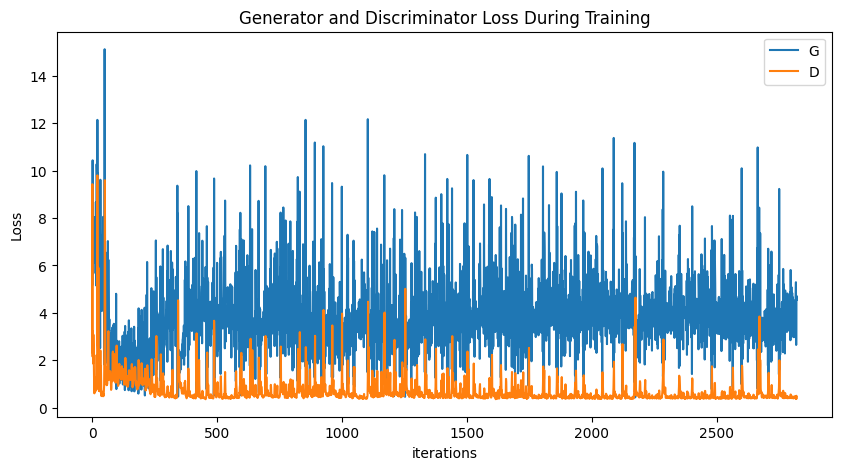

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G’s progression**

Remember how we saved the generator’s output on the fixed_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.




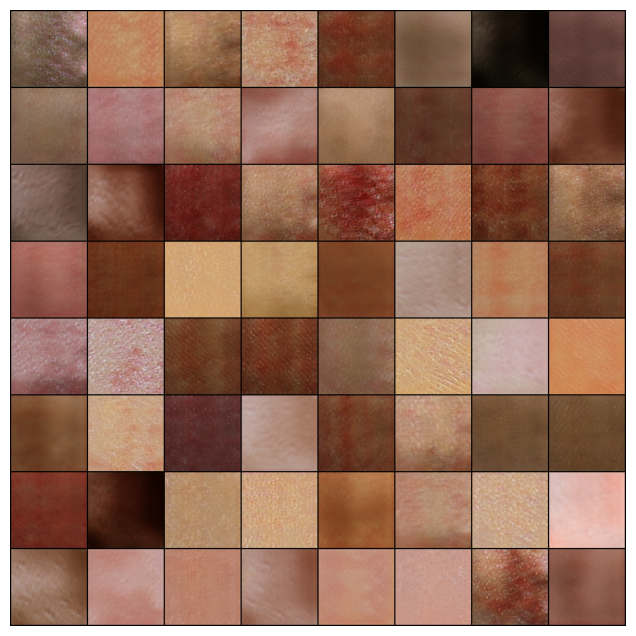

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Real Images vs. Fake Images**

Finally, lets take a look at some real images and fake images side by
side.




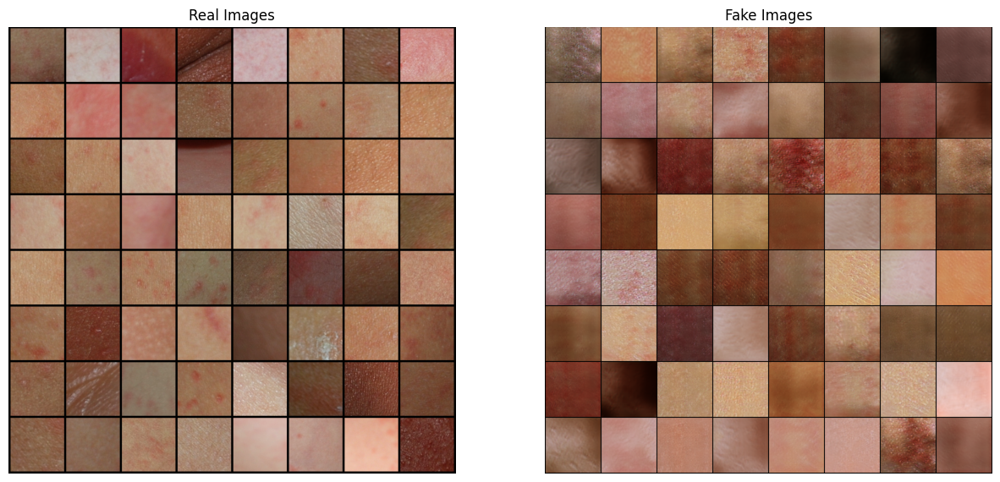

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch['img'].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()